In [22]:
#!/usr/bin/env python3
#@author narumeena
#@Description apply dimetional reduction methods 

In [23]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
from biokit.viz import corrplot
import os
#os.environ["OMP_NUM_THREADS"] = "10"
%matplotlib inline

In [24]:
codingRegionData = pd.read_csv("../analysis/trainingDataSet/case_control.tsv", sep="\t")

In [25]:
codingRegionData.to_csv("../analysis/trainingDataSet/case_control.csv", sep=",", index=False)

In [26]:
codingRegionData.shape

(138665, 103)

In [27]:
codingRegionData.head()

,Ref,Alt,Consequence,GC,CpG,motifECount,motifEHIPos,oAA,nAA,cDNApos,...,AAChange.refGene,AAChange.knownGene,AAChange.ensGene,FATHMM_score,M-CAP_score,EnsembleRegulatoryFeature,dbscSNV-ada_score,dbscSNV-rf_score,RemapOverlapTF,category
0,C,T,STOP_GAINED,0.715,0.253,NaN,NaN,Q,NaN,1107.0,...,AGRN:NM_198576:exon6:c.C1057T:p.Q353X,"AGRN:uc001ack.3:exon6:c.C1057T:p.Q353X,AGRN:uc...","AGRN:ENST00000379370.6:exon6:c.C1057T:p.Q353X,...",NaN,NaN,Promoter,NaN,NaN,21.0,1
1,C,T,REGULATORY,0.715,0.253,NaN,NaN,NaN,NaN,NaN,...,AGRN:NM_198576:exon6:c.C1057T:p.Q353X,"AGRN:uc001ack.3:exon6:c.C1057T:p.Q353X,AGRN:uc...","AGRN:ENST00000379370.6:exon6:c.C1057T:p.Q353X,...",NaN,NaN,Promoter,NaN,NaN,21.0,1
2,G,A,NON_SYNONYMOUS,0.609,0.120,NaN,NaN,G,R,5661.0,...,AGRN:NM_198576:exon33:c.G5611A:p.G1871R,"AGRN:uc001ack.3:exon33:c.G5611A:p.G1871R,AGRN:...",AGRN:ENST00000379370.6:exon33:c.G5611A:p.G1871...,-1.74,0.628,NaN,NaN,NaN,9.0,1
3,G,A,UPSTREAM,0.609,0.120,NaN,NaN,NaN,NaN,NaN,...,AGRN:NM_198576:exon33:c.G5611A:p.G1871R,"AGRN:uc001ack.3:exon33:c.G5611A:p.G1871R,AGRN:...",AGRN:ENST00000379370.6:exon33:c.G5611A:p.G1871...,-1.74,0.628,NaN,NaN,NaN,9.0,1
4,A,C,NON_SYNONYMOUS,0.675,0.213,NaN,NaN,E,D,848.0,...,B3GALT6:NM_080605:exon1:c.A795C:p.E265D,B3GALT6:uc001adk.4:exon1:c.A795C:p.E265D,B3GALT6:ENST00000379198.3:exon1:c.A795C:p.E265D,0.80,0.713,Promoter,NaN,NaN,39.0,1


In [28]:
#removing attributes with more than 20% of NaN values 

codingRegionData.columns[codingRegionData.isnull().mean() < 0.2]

Index(['Ref', 'Alt', 'Consequence', 'GC', 'CpG', 'minDistTSS', 'minDistTSE',
       'priPhCons', 'mamPhCons', 'verPhCons', 'priPhyloP', 'mamPhyloP',
       'verPhyloP', 'bStatistic', 'cHmm_E1', 'cHmm_E2', 'cHmm_E3', 'cHmm_E4',
       'cHmm_E5', 'cHmm_E6', 'cHmm_E7', 'cHmm_E8', 'cHmm_E9', 'cHmm_E10',
       'cHmm_E11', 'cHmm_E12', 'cHmm_E13', 'cHmm_E14', 'cHmm_E15', 'cHmm_E16',
       'cHmm_E17', 'cHmm_E18', 'cHmm_E19', 'cHmm_E20', 'cHmm_E21', 'cHmm_E22',
       'cHmm_E23', 'cHmm_E24', 'cHmm_E25', 'GerpN', 'GerpS',
       'EncodeH3K4me1-max', 'EncodeH3K4me2-max', 'EncodeH3K4me3-max',
       'EncodeH3K9ac-max', 'EncodeH3K9me3-max', 'EncodeH3K27ac-max',
       'EncodeH3K27me3-max', 'EncodeH3K36me3-max', 'EncodeH3K79me2-max',
       'EncodeH4K20me1-max', 'EncodeH2AFZ-max', 'EncodeDNase-max',
       'EncodetotalRNA-max', 'category'],
      dtype='object')

In [29]:
#save the attributes to diffrent dataframe for PCA and other dimetional reduction methods 
filtredAttributes = codingRegionData[codingRegionData.columns[codingRegionData.isnull().mean() < 0.3]]

In [30]:
#filtredAttributes.to_csv("../analysis/trainingDataSet/case_control_filtred.csv", sep=",", index=False)
filtredAttributes.shape

(138665, 56)

In [31]:
filtredAttributes.head()

,Ref,Alt,Consequence,GC,CpG,minDistTSS,minDistTSE,priPhCons,mamPhCons,verPhCons,...,EncodeH3K27ac-max,EncodeH3K27me3-max,EncodeH3K36me3-max,EncodeH3K79me2-max,EncodeH4K20me1-max,EncodeH2AFZ-max,EncodeDNase-max,EncodetotalRNA-max,RemapOverlapTF,category
0,C,T,STOP_GAINED,0.715,0.253,6715,185,0.011,0.001,0.0,...,0.82,1.71,4.85,5.68,9.77,3.58,0.35,9.02,21.0,1
1,C,T,REGULATORY,0.715,0.253,6715,185,0.011,0.001,0.0,...,0.82,1.71,4.85,5.68,9.77,3.58,0.35,9.02,21.0,1
2,G,A,NON_SYNONYMOUS,0.609,0.120,212,2176,0.039,0.984,1.0,...,0.92,2.15,4.78,2.63,1.94,0.87,0.37,4.20,9.0,1
3,G,A,UPSTREAM,0.609,0.120,212,2176,0.039,0.984,1.0,...,0.92,2.15,4.78,2.63,1.94,0.87,0.37,4.20,9.0,1
4,A,C,NON_SYNONYMOUS,0.675,0.213,814,1969,0.192,0.999,1.0,...,2.89,1.20,5.65,28.99,2.07,3.21,0.34,2.89,39.0,1


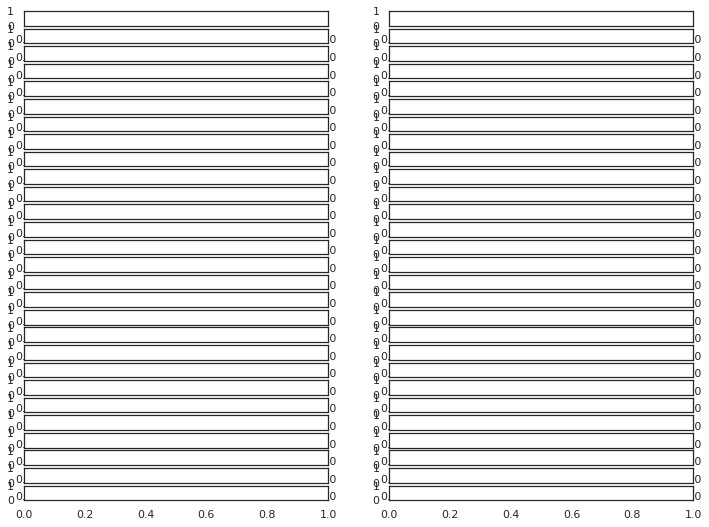

In [32]:
#histogram of each attribtes 

fig,axes =plt.subplots(28,2, figsize=(12, 9)) # 2 columns each containing 28 figures, total 56 features


pathogenic=filtredAttributes[filtredAttributes[['category']]==1] # define malignant
benign=filtredAttributes[filtredAttributes[['category']]==0] # define benign





In [33]:
filtredAttributes[['category']]

,category
0,1
1,1
2,1
3,1
4,1
...,...
138660,0
138661,0
138662,0
138663,0


In [34]:
# One-hot encode the data using pandas get_dummies
filtredAttributes = pd.get_dummies(filtredAttributes)

In [35]:
filtredAttributes.head()

,GC,CpG,minDistTSS,minDistTSE,priPhCons,mamPhCons,verPhCons,priPhyloP,mamPhyloP,verPhyloP,...,Consequence_DOWNSTREAM,Consequence_INTRONIC,Consequence_NONCODING_CHANGE,Consequence_NON_SYNONYMOUS,Consequence_REGULATORY,Consequence_SPLICE_SITE,Consequence_STOP_GAINED,Consequence_STOP_LOST,Consequence_SYNONYMOUS,Consequence_UPSTREAM
0,0.715,0.253,6715,185,0.011,0.001,0.0,-0.646,0.096,0.126,...,0,0,0,0,0,0,1,0,0,0
1,0.715,0.253,6715,185,0.011,0.001,0.0,-0.646,0.096,0.126,...,0,0,0,0,1,0,0,0,0,0
2,0.609,0.120,212,2176,0.039,0.984,1.0,0.595,4.158,5.651,...,0,0,0,1,0,0,0,0,0,0
3,0.609,0.120,212,2176,0.039,0.984,1.0,0.595,4.158,5.651,...,0,0,0,0,0,0,0,0,0,1
4,0.675,0.213,814,1969,0.192,0.999,1.0,-1.149,0.850,3.250,...,0,0,0,1,0,0,0,0,0,0


In [ ]:
#list of attributes 

features = ['GC', 'CpG', 'minDistTSS', 'minDistTSE', 'priPhCons', 'mamPhCons',
       'verPhCons', 'priPhyloP', 'mamPhyloP', 'verPhyloP', 'bStatistic',
       'cHmm_E1', 'cHmm_E2', 'cHmm_E3', 'cHmm_E4', 'cHmm_E5', 'cHmm_E6',
       'cHmm_E7', 'cHmm_E8', 'cHmm_E9', 'cHmm_E10', 'cHmm_E11', 'cHmm_E12',
       'cHmm_E13', 'cHmm_E14', 'cHmm_E15', 'cHmm_E16', 'cHmm_E17', 'cHmm_E18',
       'cHmm_E19', 'cHmm_E20', 'cHmm_E21', 'cHmm_E22', 'cHmm_E23', 'cHmm_E24',
       'cHmm_E25', 'GerpN', 'GerpS', 'EncodeH3K4me1-max', 'EncodeH3K4me2-max',
       'EncodeH3K4me3-max', 'EncodeH3K9ac-max', 'EncodeH3K9me3-max',
       'EncodeH3K27ac-max', 'EncodeH3K27me3-max', 'EncodeH3K36me3-max',
       'EncodeH3K79me2-max', 'EncodeH4K20me1-max', 'EncodeH2AFZ-max',
       'EncodeDNase-max', 'EncodetotalRNA-max', 'Ref_A', 'Ref_C',
       'Ref_G', 'Ref_T', 'Alt_A', 'Alt_C', 'Alt_G', 'Alt_T',
       'Consequence_3PRIME_UTR', 'Consequence_5PRIME_UTR',
       'Consequence_CANONICAL_SPLICE', 'Consequence_DOWNSTREAM',
       'Consequence_INTRONIC', 'Consequence_NONCODING_CHANGE',
       'Consequence_NON_SYNONYMOUS', 'Consequence_REGULATORY',
       'Consequence_SPLICE_SITE', 'Consequence_STOP_GAINED',
       'Consequence_STOP_LOST', 'Consequence_SYNONYMOUS',
       'Consequence_UPSTREAM']

# Separating out the features
a = filtredAttributes.reindex(columns= features, fill_value=0).values
# Separating out the target
b = filtredAttributes.reindex(columns=['category']).values

In [34]:
# Standardizing the features
a = StandardScaler().fit_transform(a)

In [35]:
a[:10]

array([[ 1.98183417e+00,  3.69545173e+00, -2.79214651e-01,
        -3.45897266e-01, -9.00911382e-01, -9.13504003e-01,
        -9.08175969e-01, -1.06009925e+00, -5.31259207e-01,
        -6.22547499e-01,  1.00495427e+00,  1.50600236e+00,
         6.49747826e-01, -3.45215196e-01, -4.32013445e-01,
         8.45106433e-01,  1.32743004e+00, -6.59364794e-01,
        -2.93521225e-01,  1.99375967e-01,  1.25018385e+00,
         9.36199566e-01,  9.17624618e-03, -3.12219849e-01,
        -4.99978608e-01,  1.08605586e-01, -2.81655844e-01,
        -2.64331862e-01, -2.51606542e-01,  9.06761474e-02,
        -1.89411631e-01,  2.39185901e-01,  8.44224666e-01,
         2.30233965e+00,  9.77495077e-01, -2.70448346e-01,
         5.40700975e-01, -2.41720079e+00, -4.52206731e-01,
        -2.67905479e-01, -3.33655852e-01, -3.17797042e-01,
        -5.29039449e-01, -4.54085813e-01, -2.62372701e-01,
        -9.66083634e-02, -4.33258615e-02,  1.76243753e+00,
         7.88420021e-03, -7.60887411e-02,  1.64704739e-0

In [36]:
a = np.nan_to_num(a)

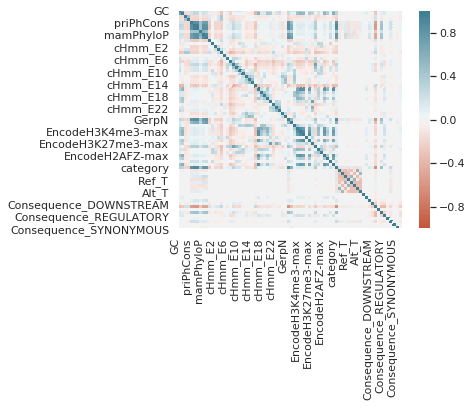

In [37]:
#Visulization 1 
#heatmap 

corr = filtredAttributes.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)


sns.set(rc={'figure.figsize':(150.7,120.27)})
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=90,
    horizontalalignment='right'
);

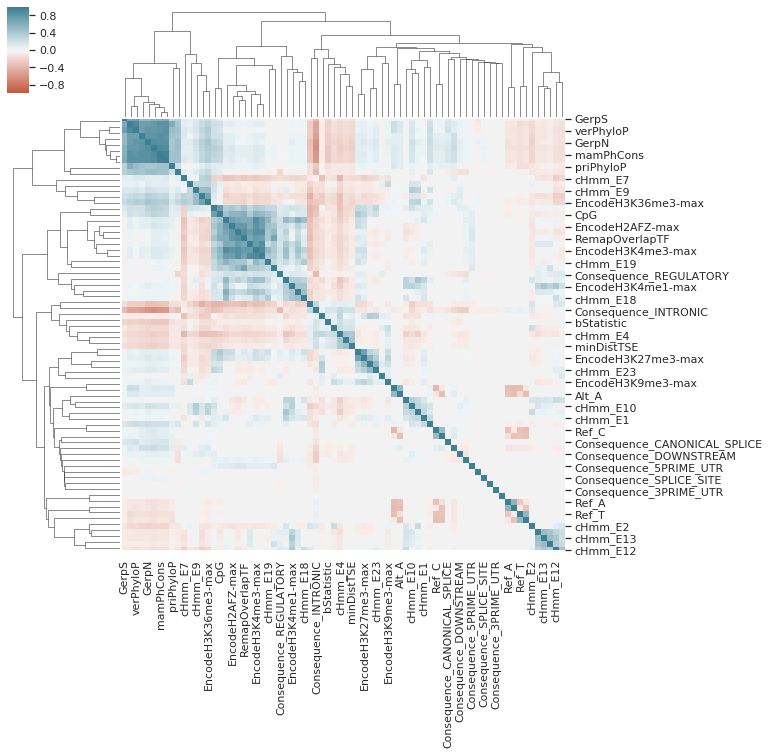

In [52]:
#Visulization 2 
#Clustermap

ax = sns.clustermap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)


sns.set(rc={'figure.figsize':(150.7,120.27)})



Populating the interactive namespace from numpy and matplotlib


/home/narumeena/anaconda3/lib/python3.7/site-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['var']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


<Figure size 22000x22000 with 0 Axes>

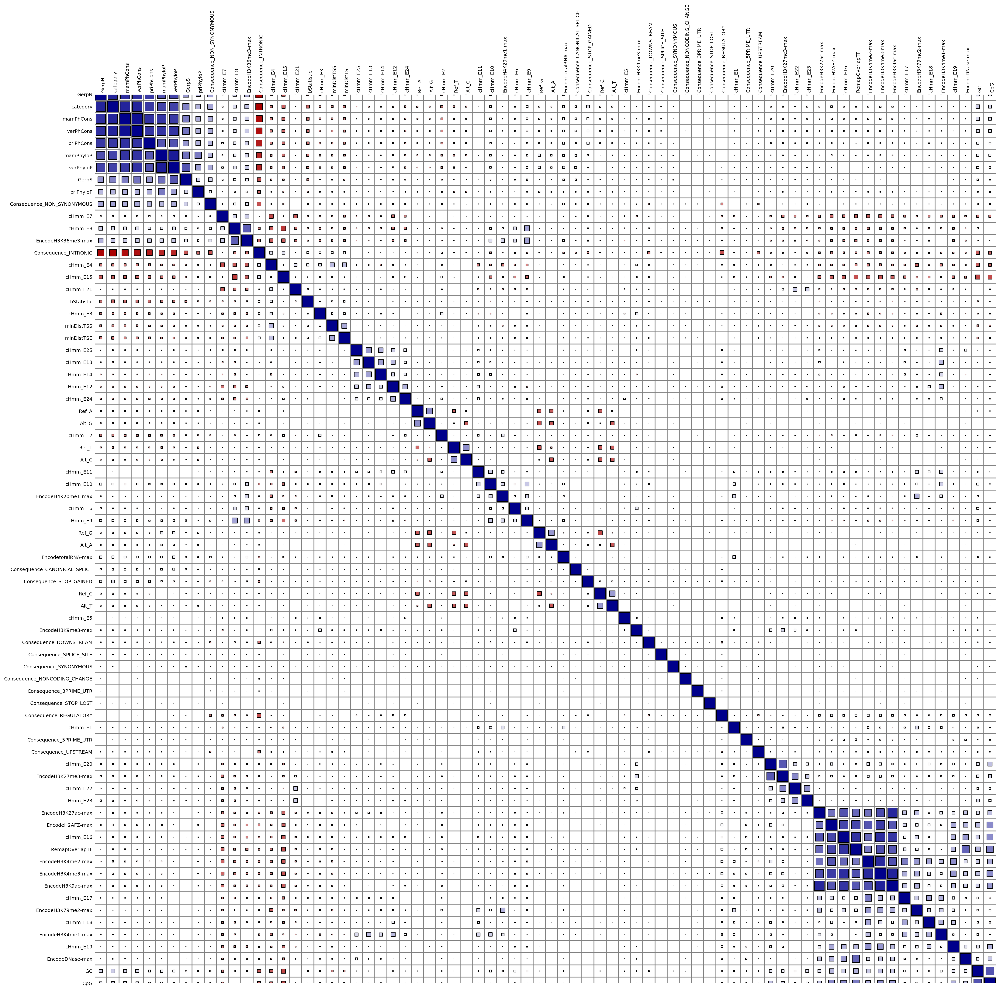

In [53]:
#Visulization 3 
#Heatmap with box view 

%pylab inline

matplotlib.rcParams['figure.dpi'] = 220
matplotlib.rcParams['figure.figsize'] = (32,24)
plt.figure(figsize=(100, 100))
c = corrplot.Corrplot(corr)
c.plot(colorbar=False, method='square', shrink=.9 ,rotation=90)

In [54]:
#Visulization 4
#PCA 

pca = PCA(n_components=2)
principalComponents = pca.fit_transform(a)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['Principal Component 1','Principal Component 2'])

In [55]:
finalDf = pd.concat([principalDf, filtredAttributes[['category']]], axis = 1)

In [56]:
fig = plt.figure(figsize = (60,40))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = [1,0]
colors = ['r', 'g', 'b']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['category'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'Principal Component 1']
               , finalDf.loc[indicesToKeep, 'Principal Component 2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

In [57]:
covar_matrix = PCA(n_components = 70) #we have 20 features
#calculating eigen values 
covar_matrix.fit_transform(a)
variance = covar_matrix.explained_variance_ratio_ #calculate variance ratios

var=np.cumsum(np.round(covar_matrix.explained_variance_ratio_, decimals=3)*100)
var #cumulative sum of variance explained with [n] features

array([12.3, 21.8, 27. , 31.5, 35. , 38.1, 41. , 43.7, 46.2, 48.6, 50.7,
       52.7, 54.5, 56.1, 57.7, 59.2, 60.7, 62.2, 63.6, 65. , 66.4, 67.8,
       69.2, 70.6, 72. , 73.3, 74.6, 75.8, 77. , 78.2, 79.4, 80.5, 81.6,
       82.6, 83.6, 84.5, 85.4, 86.3, 87.1, 87.9, 88.6, 89.3, 90. , 90.7,
       91.4, 92.1, 92.7, 93.3, 93.9, 94.5, 95.1, 95.6, 96.1, 96.6, 97. ,
       97.4, 97.8, 98.1, 98.4, 98.6, 98.8, 99. , 99.2, 99.4, 99.5, 99.6,
       99.7, 99.8, 99.8, 99.8])

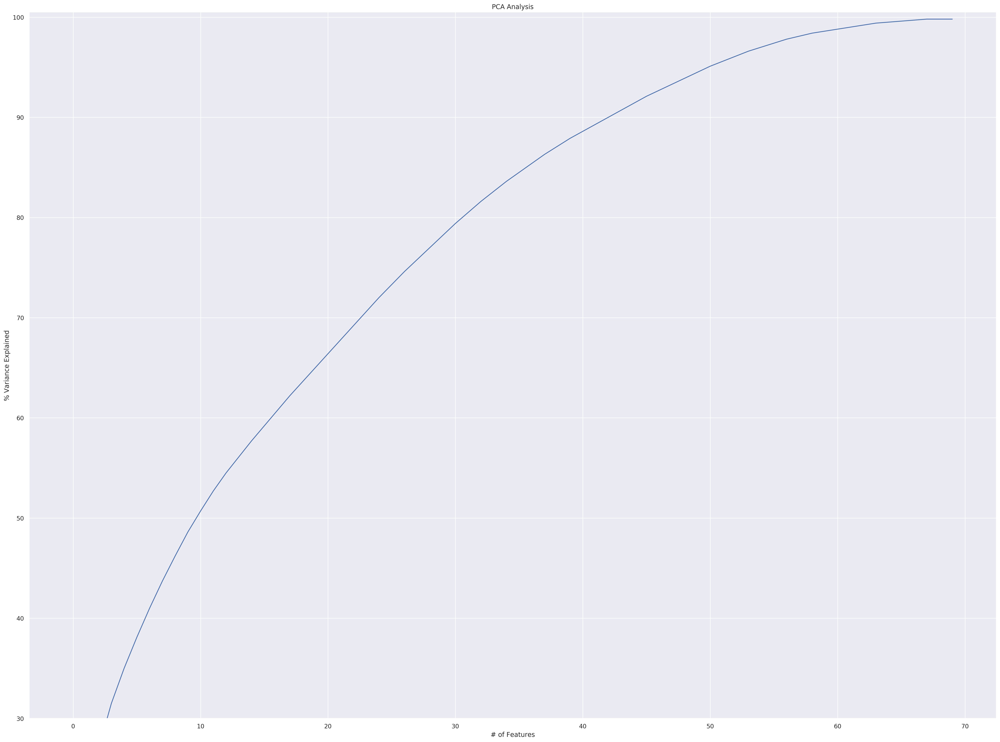

In [58]:
plt.ylabel('% Variance Explained')
plt.xlabel('# of Features')
plt.title('PCA Analysis')
plt.ylim(30,100.5)
plt.style.context('seaborn-whitegrid')


plt.plot(var)

In [ ]:
#Visulization 5 
#pair plot

sns.set(style='white', context='notebook', rc={'figure.figsize':(200,200)})

In [17]:
pairplot = filtredAttributes.reindex(columns= ['GC', 'CpG', 'minDistTSS', 'minDistTSE', 'priPhCons', 'mamPhCons',
       'verPhCons', 'priPhyloP', 'mamPhyloP', 'verPhyloP', 'bStatistic',
       'cHmm_E1', 'cHmm_E2', 'cHmm_E3', 'cHmm_E4', 'cHmm_E5', 'cHmm_E6',
       'cHmm_E7', 'cHmm_E8', 'cHmm_E9', 'cHmm_E10', 'cHmm_E11', 'cHmm_E12',
       'cHmm_E13', 'cHmm_E14', 'cHmm_E15', 'cHmm_E16', 'cHmm_E17', 'cHmm_E18',
       'cHmm_E19', 'cHmm_E20', 'cHmm_E21', 'cHmm_E22', 'cHmm_E23', 'cHmm_E24',
       'cHmm_E25', 'GerpN', 'GerpS', 'EncodeH3K4me1-max', 'EncodeH3K4me2-max',
       'EncodeH3K4me3-max', 'EncodeH3K9ac-max', 'EncodeH3K9me3-max',
       'EncodeH3K27ac-max', 'EncodeH3K27me3-max', 'EncodeH3K36me3-max',
       'EncodeH3K79me2-max', 'EncodeH4K20me1-max', 'EncodeH2AFZ-max',
       'EncodeDNase-max', 'EncodetotalRNA-max', 'category', 'Ref_A', 'Ref_C',
       'Ref_G', 'Ref_T', 'Alt_A', 'Alt_C', 'Alt_G', 'Alt_T',
       'Consequence_3PRIME_UTR', 'Consequence_5PRIME_UTR',
       'Consequence_CANONICAL_SPLICE', 'Consequence_DOWNSTREAM',
       'Consequence_INTRONIC', 'Consequence_NONCODING_CHANGE',
       'Consequence_NON_SYNONYMOUS', 'Consequence_REGULATORY',
       'Consequence_SPLICE_SITE', 'Consequence_STOP_GAINED',
       'Consequence_STOP_LOST', 'Consequence_SYNONYMOUS',
       'Consequence_UPSTREAM'], fill_value=0)
pairplot['category'] = pd.Series(np.asarray(pairplot['category'])).map(lambda x: 'category {}'.format(x))
sns.pairplot(pairplot, hue='category');

/home/narumeena/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/home/narumeena/anaconda3/lib/python3.7/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


In [36]:
#visulization 6 
#UMAP 

In [37]:
from sklearn.datasets import load_iris, load_digits
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
%matplotlib inline
import umap


In [38]:
umap.__version__

'0.4.0rc1'

In [39]:
import platform
 
print(platform.python_version())

3.7.4


In [40]:
import umap

In [41]:
reducer = umap.UMAP()

In [42]:
#missing values 

filtredAttributes['priPhCons'].fillna(0.115,inplace=True)
filtredAttributes['mamPhCons'].fillna(0.079,inplace=True)
filtredAttributes['verPhCons'].fillna(0.094,inplace=True)
filtredAttributes['priPhyloP'].fillna(-0.033,inplace=True)
filtredAttributes['mamPhyloP'].fillna(-0.038,inplace=True)
filtredAttributes['verPhyloP'].fillna(0.017,inplace=True)
filtredAttributes['bStatistic'].fillna(800.261,inplace=True)
filtredAttributes['minDistTSS'].fillna(10000000,inplace=True)
filtredAttributes['minDistTSE'].fillna(10000000,inplace=True)
filtredAttributes['RemapOverlapTF'].fillna(0.5,inplace=True)
filtredAttributes['EncodeH3K4me1-max'].fillna(0,inplace=True)
filtredAttributes['EncodeH3K4me2-max'].fillna(0,inplace=True)
filtredAttributes['EncodeH3K4me3-max'].fillna(0,inplace=True)
filtredAttributes['EncodeH3K9ac-max'].fillna(0,inplace=True)
filtredAttributes['EncodeH3K9me3-max'].fillna(0,inplace=True)
filtredAttributes['EncodeH3K27ac-max'].fillna(0,inplace=True)
filtredAttributes['EncodeH3K27me3-max'].fillna(0,inplace=True)
filtredAttributes['EncodeH3K36me3-max'].fillna(0,inplace=True)
filtredAttributes['EncodeH3K79me2-max'].fillna(0,inplace=True)
filtredAttributes['EncodeH4K20me1-max'].fillna(0,inplace=True)
filtredAttributes['EncodeH2AFZ-max'].fillna(0,inplace=True)
filtredAttributes['EncodetotalRNA-max'].fillna(0,inplace=True)
filtredAttributes['EncodeDNase-max'].fillna(0,inplace=True)

In [43]:
#list of attributes 

features = ['GC', 'CpG', 'minDistTSS', 'minDistTSE', 'priPhCons', 'mamPhCons',
       'verPhCons', 'priPhyloP', 'mamPhyloP', 'verPhyloP', 'bStatistic',
       'cHmm_E1', 'cHmm_E2', 'cHmm_E3', 'cHmm_E4', 'cHmm_E5', 'cHmm_E6',
       'cHmm_E7', 'cHmm_E8', 'cHmm_E9', 'cHmm_E10', 'cHmm_E11', 'cHmm_E12',
       'cHmm_E13', 'cHmm_E14', 'cHmm_E15', 'cHmm_E16', 'cHmm_E17', 'cHmm_E18',
       'cHmm_E19', 'cHmm_E20', 'cHmm_E21', 'cHmm_E22', 'cHmm_E23', 'cHmm_E24',
       'cHmm_E25', 'GerpN', 'GerpS', 'EncodeH3K4me1-max', 'EncodeH3K4me2-max',
       'EncodeH3K4me3-max', 'EncodeH3K9ac-max', 'EncodeH3K9me3-max',
       'EncodeH3K27ac-max', 'EncodeH3K27me3-max', 'EncodeH3K36me3-max',
       'EncodeH3K79me2-max', 'EncodeH4K20me1-max', 'EncodeH2AFZ-max',
       'EncodeDNase-max', 'EncodetotalRNA-max', 'Ref_A', 'Ref_C',
       'Ref_G', 'Ref_T', 'Alt_A', 'Alt_C', 'Alt_G', 'Alt_T',
       'Consequence_3PRIME_UTR', 'Consequence_5PRIME_UTR',
       'Consequence_CANONICAL_SPLICE', 'Consequence_DOWNSTREAM',
       'Consequence_INTRONIC', 'Consequence_NONCODING_CHANGE',
       'Consequence_NON_SYNONYMOUS', 'Consequence_REGULATORY',
       'Consequence_SPLICE_SITE', 'Consequence_STOP_GAINED',
       'Consequence_STOP_LOST', 'Consequence_SYNONYMOUS',
       'Consequence_UPSTREAM']

# Separating out the features
a = filtredAttributes.reindex(columns= features).values
#a = filtredAttributes.reindex(columns= [  'minDistTSE', 'priPhCons', 'priPhyloP', 'bStatistic',
#       'GerpN', 'GerpS',  'EncodetotalRNA-max']).values
# Separating out the target
b = filtredAttributes.reindex(columns=['category']).values

In [44]:
a[1]

array([ 7.150e-01,  2.530e-01,  6.715e+03,  1.850e+02,  1.100e-02,
        1.000e-03,  0.000e+00, -6.460e-01,  9.600e-02,  1.260e-01,
        9.400e+02,  2.000e+00,  1.000e+00,  0.000e+00,  2.000e+00,
        1.000e+00,  3.000e+00,  2.000e+00,  3.000e+00,  1.000e+00,
        4.000e+00,  3.000e+00,  1.000e+00,  0.000e+00,  0.000e+00,
        1.300e+01,  0.000e+00,  0.000e+00,  0.000e+00,  1.000e+00,
        0.000e+00,  3.000e+00,  3.000e+00,  3.000e+00,  2.000e+00,
        0.000e+00,  1.380e+01, -2.770e+01,  2.120e+00,  3.750e+00,
        1.980e+00,  2.070e+00,  1.180e+00,  8.200e-01,  1.710e+00,
        4.850e+00,  5.680e+00,  9.770e+00,  3.580e+00,  3.500e-01,
        9.020e+00,  0.000e+00,  1.000e+00,  0.000e+00,  0.000e+00,
        0.000e+00,  0.000e+00,  0.000e+00,  1.000e+00,  0.000e+00,
        0.000e+00,  0.000e+00,  0.000e+00,  0.000e+00,  0.000e+00,
        0.000e+00,  1.000e+00,  0.000e+00,  0.000e+00,  0.000e+00,
        0.000e+00,  0.000e+00])

In [45]:
b

array([[1],
       [1],
       [1],
       ...,
       [0],
       [0],
       [0]])

In [46]:
np.concatenate(b).ravel()

array([1, 1, 1, ..., 0, 0, 0])

In [ ]:
embedding = reducer.fit_transform(a)
embedding.shape

In [ ]:
plt.scatter(embedding[:, 0], embedding[:, 1], c=[sns.color_palette()[x] for x in np.concatenate(b).ravel()],cmap='Spectral', s=5)
#plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the dataset', fontsize=24);

In [47]:
import numpy as np
import numba
import sklearn.datasets
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
import umap
%matplotlib inline

In [48]:
sns.set(style='white', rc={'figure.figsize':(10,10)})

In [ ]:
plane_mapper = umap.UMAP(n_neighbors=80,init='random').fit(a)

In [ ]:
plt.scatter(plane_mapper.embedding_.T[0], plane_mapper.embedding_.T[1], c=np.concatenate(b).ravel(), cmap='Spectral')

In [ ]:
#correlation
#haversine
sphere_mapper = umap.UMAP(output_metric='correlation',n_neighbors=80,init='random').fit(a)

In [ ]:
plt.scatter(sphere_mapper.embedding_.T[0], sphere_mapper.embedding_.T[1], c=np.concatenate(b).ravel(), cmap='Spectral')

In [ ]:
x = np.sin(sphere_mapper.embedding_[:, 0]) * np.cos(sphere_mapper.embedding_[:, 1])
y = np.sin(sphere_mapper.embedding_[:, 0]) * np.sin(sphere_mapper.embedding_[:, 1])
z = np.cos(sphere_mapper.embedding_[:, 0])

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, c=np.concatenate(b).ravel(), cmap='Spectral')

In [ ]:
x = np.arctan2(x, y)
y = -np.arccos(z)

In [ ]:
plt.scatter(x, y, c=np.concatenate(b).ravel().astype(np.int32), cmap='Spectral')

In [ ]:
gaussian_mapper = umap.UMAP(output_metric='gaussian_energy',n_neighbors=80,init='random',
                            n_components=5).fit(a)

In [ ]:
plt.scatter(gaussian_mapper.embedding_.T[0], gaussian_mapper.embedding_.T[1], c=np.concatenate(b).ravel(), cmap='Spectral')


In [ ]:
from matplotlib.patches import Ellipse

def draw_simple_ellipse(position, width, height, angle,
                        ax=None, from_size=0.1, to_size=0.5, n_ellipses=3,
                        alpha=0.1, color=None,
                        **kwargs):
    ax = ax or plt.gca()
    angle = (angle / np.pi) * 180
    width, height = np.sqrt(width), np.sqrt(height)
    # Draw the Ellipse
    for nsig in np.linspace(from_size, to_size, n_ellipses):
        ax.add_patch(Ellipse(position, nsig * width, nsig * height,
                             angle, alpha=alpha, lw=0, color=color, **kwargs))

In [ ]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
colors = plt.get_cmap('Spectral')(np.linspace(0, 1, 10))
for i in range(gaussian_mapper.embedding_.shape[0]):
    pos = gaussian_mapper.embedding_[i, :2]
    draw_simple_ellipse(pos, gaussian_mapper.embedding_[i, 2],
                        gaussian_mapper.embedding_[i, 3],
                        gaussian_mapper.embedding_[i, 4],
                        ax, color=colors[np.concatenate(b).ravel()[i]],
                        from_size=0.2, to_size=1.0, alpha=0.05)
ax.scatter(gaussian_mapper.embedding_.T[0],
           gaussian_mapper.embedding_.T[1],
           c=digits.target, cmap='Spectral', s=3)

In [ ]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
for i in range(gaussian_mapper.embedding_.shape[0]):
    pos = gaussian_mapper.embedding_[i, :2]
    draw_simple_ellipse(pos, gaussian_mapper.embedding_[i, 2],
                        gaussian_mapper.embedding_[i, 3],
                        gaussian_mapper.embedding_[i, 4],
                        ax, n_ellipses=1,
                        color=colors[np.concatenate(b).ravel()[i]],
                        from_size=1.0, to_size=1.0, alpha=0.01)
ax.scatter(gaussian_mapper.embedding_.T[0],
           gaussian_mapper.embedding_.T[1],
           c=digits.target, cmap='Spectral', s=3)